 # Earthquakes in Indonesia
_Gempa di Indonesia_

## Anggota Kelompok

1. I Putu Natha Kusuma (235150201111023)
2. Qori Imaduddin (235150200111023)
3. Yoga Raditya Nala (235150201111020)

## Import Data

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import numpy as np

In [2]:
df = pd.read_csv("https://raw.githubusercontent.com/nathakusuma/stp-data-gempa/main/katalog_gempa.csv")
df

,tgl,ot,lat,lon,depth,mag,remark,strike1,dip1,rake1,strike2,dip2,rake2
0,2008/11/01,21:02:43.058,-9.18,119.06,10,4.9,Sumba Region - Indonesia,NaN,NaN,NaN,NaN,NaN,NaN
1,2008/11/01,20:58:50.248,-6.55,129.64,10,4.6,Banda Sea,NaN,NaN,NaN,NaN,NaN,NaN
2,2008/11/01,17:43:12.941,-7.01,106.63,121,3.7,Java - Indonesia,NaN,NaN,NaN,NaN,NaN,NaN
3,2008/11/01,16:24:14.755,-3.30,127.85,10,3.2,Seram - Indonesia,NaN,NaN,NaN,NaN,NaN,NaN
4,2008/11/01,16:20:37.327,-6.41,129.54,70,4.3,Banda Sea,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
92882,2023/01/26,02:25:09.288,3.24,127.18,10,4.0,Talaud Islands - Indonesia,NaN,NaN,NaN,NaN,NaN,NaN
92883,2023/01/26,02:15:03.893,2.70,127.10,10,3.9,Northern Molucca Sea,NaN,NaN,NaN,NaN,NaN,NaN
92884,2023/01/26,01:57:08.885,-7.83,121.07,10,3.8,Flores Sea,NaN,NaN,NaN,NaN,NaN,NaN
92885,2023/01/26,01:46:21.009,3.00,127.16,10,4.1,Northern Molucca Sea,NaN,NaN,NaN,NaN,NaN,NaN


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92887 entries, 0 to 92886
Data columns (total 13 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   tgl      92887 non-null  object 
 1   ot       92887 non-null  object 
 2   lat      92887 non-null  float64
 3   lon      92887 non-null  float64
 4   depth    92887 non-null  int64  
 5   mag      92887 non-null  float64
 6   remark   92887 non-null  object 
 7   strike1  2735 non-null   float64
 8   dip1     2735 non-null   float64
 9   rake1    2735 non-null   float64
 10  strike2  2735 non-null   float64
 11  dip2     2735 non-null   float64
 12  rake2    2735 non-null   float64
dtypes: float64(9), int64(1), object(3)
memory usage: 9.2+ MB


## Tentang Dataset

Dataset ini berasal dari BMKG yang berisi tentang kejadian gempa dari 1 November 2008 hingga 26 Januari 2023 yang memiliki **92887 record data**.

Variabel yang ada di dataset ini:
- `tgl` (object): tanggal kejadian
- `ot` (object): timestamp kejadian
- `lat` (float64): garis lintang episentrum kejadian (derajat), berkisar antara 6N sampai 11S
- `lon` (float64): garis bujur episentrum peristiwa (derajat), berkisar antara 142E sampai 94E
- `depth` (int64): kedalaman kejadian (km)
- `mag` (float64): magnitudo kejadian, berkisar dari 1 hingga 9.5
- `remark` (object): Flinn-Engdahl regions dari kejadian

## Data Preparation

### Perbaiki format tanggal dan waktu

In [4]:
df['datetime'] = pd.to_datetime(df['tgl'] + ' ' + df['ot'])
df['year'] = df['datetime'].dt.year
df['month'] = df['datetime'].dt.month_name()
df['hour'] = df['datetime'].dt.hour
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92887 entries, 0 to 92886
Data columns (total 17 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   tgl       92887 non-null  object        
 1   ot        92887 non-null  object        
 2   lat       92887 non-null  float64       
 3   lon       92887 non-null  float64       
 4   depth     92887 non-null  int64         
 5   mag       92887 non-null  float64       
 6   remark    92887 non-null  object        
 7   strike1   2735 non-null   float64       
 8   dip1      2735 non-null   float64       
 9   rake1     2735 non-null   float64       
 10  strike2   2735 non-null   float64       
 11  dip2      2735 non-null   float64       
 12  rake2     2735 non-null   float64       
 13  datetime  92887 non-null  datetime64[ns]
 14  year      92887 non-null  int32         
 15  month     92887 non-null  object        
 16  hour      92887 non-null  int32         
dtypes: datetime6

### Ganti urutan kolom pada dataframe

In [5]:
new_cols = ['remark', 'mag', 'depth', 'datetime', 'lat', 'lon', 'year', 'month', 'hour']
df = df[new_cols]
df = df.reindex(columns = new_cols)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92887 entries, 0 to 92886
Data columns (total 9 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   remark    92887 non-null  object        
 1   mag       92887 non-null  float64       
 2   depth     92887 non-null  int64         
 3   datetime  92887 non-null  datetime64[ns]
 4   lat       92887 non-null  float64       
 5   lon       92887 non-null  float64       
 6   year      92887 non-null  int32         
 7   month     92887 non-null  object        
 8   hour      92887 non-null  int32         
dtypes: datetime64[ns](1), float64(3), int32(2), int64(1), object(2)
memory usage: 5.7+ MB


### Rename kolom

In [6]:
df.rename(columns = {'remark': 'location', 'mag': 'magnitude', 'depth': 'depth_km',
                     'lat': 'latitude', 'lon': 'longitude'}, inplace = True)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92887 entries, 0 to 92886
Data columns (total 9 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   location   92887 non-null  object        
 1   magnitude  92887 non-null  float64       
 2   depth_km   92887 non-null  int64         
 3   datetime   92887 non-null  datetime64[ns]
 4   latitude   92887 non-null  float64       
 5   longitude  92887 non-null  float64       
 6   year       92887 non-null  int32         
 7   month      92887 non-null  object        
 8   hour       92887 non-null  int32         
dtypes: datetime64[ns](1), float64(3), int32(2), int64(1), object(2)
memory usage: 5.7+ MB


### Cek data duplikat

In [7]:
df.duplicated().sum()

2735

In [8]:
df = df.drop_duplicates()
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 90152 entries, 0 to 92886
Data columns (total 9 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   location   90152 non-null  object        
 1   magnitude  90152 non-null  float64       
 2   depth_km   90152 non-null  int64         
 3   datetime   90152 non-null  datetime64[ns]
 4   latitude   90152 non-null  float64       
 5   longitude  90152 non-null  float64       
 6   year       90152 non-null  int32         
 7   month      90152 non-null  object        
 8   hour       90152 non-null  int32         
dtypes: datetime64[ns](1), float64(3), int32(2), int64(1), object(2)
memory usage: 6.2+ MB


### Cek data null

In [9]:
df.isna().sum()

location     0
magnitude    0
depth_km     0
datetime     0
latitude     0
longitude    0
year         0
month        0
hour         0
dtype: int64

### Cek data outlier

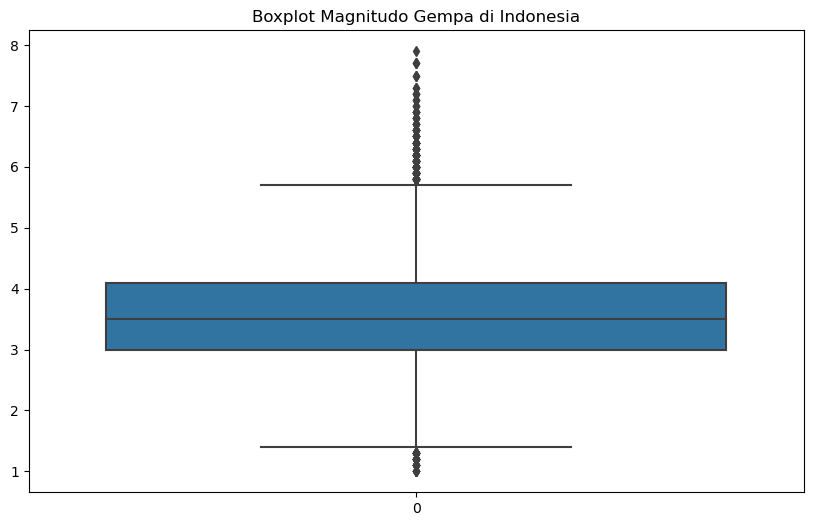

In [10]:
plt.figure(figsize=(10, 6))
sns.boxplot(df['magnitude'])
plt.title('Boxplot Magnitudo Gempa di Indonesia')
plt.show()

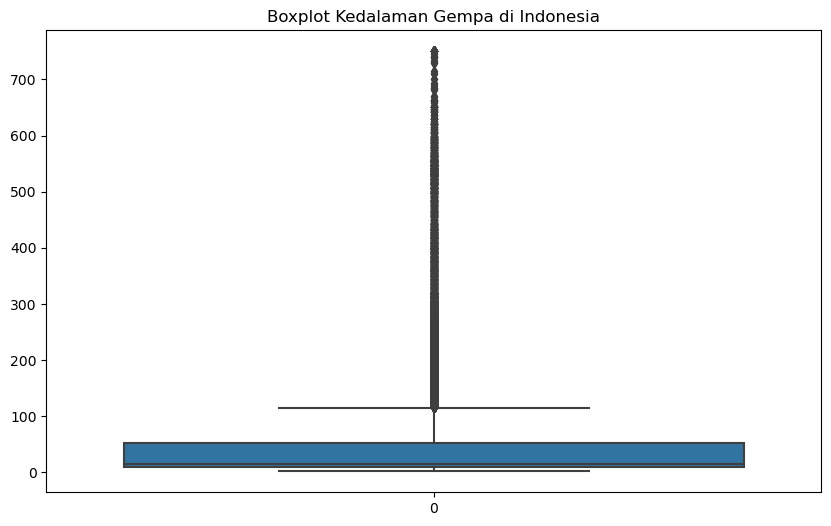

In [11]:
plt.figure(figsize=(10, 6))
sns.boxplot(df['depth_km'])
plt.title('Boxplot Kedalaman Gempa di Indonesia')
plt.show()

## Exploratory Data Analysis

In [12]:
df['location'].value_counts()

location
Minahassa Peninsula - Sulawesi        9294
Sulawesi - Indonesia                  7762
Sumbawa Region - Indonesia            7202
Java - Indonesia                      6591
Northern Sumatra - Indonesia          5763
Southern Sumatra - Indonesia          5084
Northern Molucca Sea                  4828
Banda Sea                             4723
Seram - Indonesia                     4264
Halmahera - Indonesia                 3507
Irian Jaya Region - Indonesia         3043
South of Java - Indonesia             2414
Talaud Islands - Indonesia            2319
Flores Region - Indonesia             2298
Timor Region                          1911
Flores Sea                            1844
Near North Coast of Irian Jaya        1812
Sumba Region - Indonesia              1806
Irian Jaya - Indonesia                1588
Ceram Sea                             1514
Bali Region - Indonesia               1354
Southern Molucca Sea                  1224
Off West Coast of Northern Sumatra    1002
Su

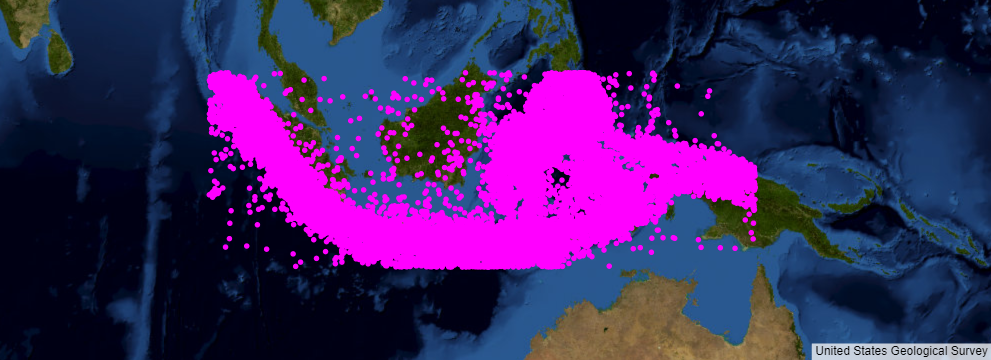

In [13]:
fig1 = px.scatter_mapbox(df, lat="latitude", lon="longitude", hover_name="location", hover_data=["magnitude", "depth_km"], color_discrete_sequence=["fuchsia"], zoom=3, height=300)
fig1.update_layout(mapbox_style = "white-bg", mapbox_layers = [{
            "below": 'traces',
            "sourcetype": "raster",
            "sourceattribution": "United States Geological Survey",
            "source": ["https://basemap.nationalmap.gov/arcgis/rest/services/USGSImageryOnly/MapServer/tile/{z}/{y}/{x}"]}])
fig1.update_layout(margin = {"r":0,"t":0,"l":0,"b":0})
fig1.show()

### Analisis berdasarkan magnitudo

In [14]:
df.sort_values(by='magnitude', ascending=False)

,location,magnitude,depth_km,datetime,latitude,longitude,year,month,hour
345,Irian Jaya Region - Indonesia,7.9,17,2009-01-03 19:43:54.962,-0.54,132.89,2009,January,19
2472,Southern Sumatra - Indonesia,7.7,81,2009-09-30 10:16:10.432,-0.80,99.88,2009,September,10
5480,Northern Sumatra - Indonesia,7.7,29,2010-04-06 22:15:03.209,2.24,97.11,2010,April,22
25283,Southwest of Sumatra - Indonesia,7.7,19,2016-03-02 12:49:47.458,-4.92,94.31,2016,March,12
331,Irian Jaya Region - Indonesia,7.5,51,2009-01-03 22:33:45.363,-0.82,133.41,2009,January,22
...,...,...,...,...,...,...,...,...,...
77447,Sulawesi - Indonesia,1.0,10,2021-09-24 14:43:13.253,-2.42,121.13,2021,September,14
73426,Flores Region - Indonesia,1.0,14,2021-05-07 18:26:56.891,-8.64,121.78,2021,May,18
75131,Southern Sumatra - Indonesia,1.0,21,2021-07-01 15:53:05.379,-5.59,104.59,2021,July,15
75400,Flores Region - Indonesia,1.0,10,2021-07-04 03:26:41.348,-8.60,121.48,2021,July,3


Rata-rata, standar deviasi, kuartil, median

In [15]:
df['magnitude'].describe()

count    90152.000000
mean         3.550424
std          0.803019
min          1.000000
25%          3.000000
50%          3.500000
75%          4.100000
max          7.900000
Name: magnitude, dtype: float64

Desil

In [16]:
np.percentile(df['magnitude'], np.arange(0, 100, 10))

array([1. , 2.5, 2.9, 3.1, 3.3, 3.5, 3.7, 4. , 4.3, 4.6])

Simpangan rata-rata

In [17]:
mean_value = df['magnitude'].mean()

absolute_difference = abs(df['magnitude'] - mean_value)

mean_absolute_deviation = absolute_difference.mean()

mean_absolute_deviation

0.6529195419111377

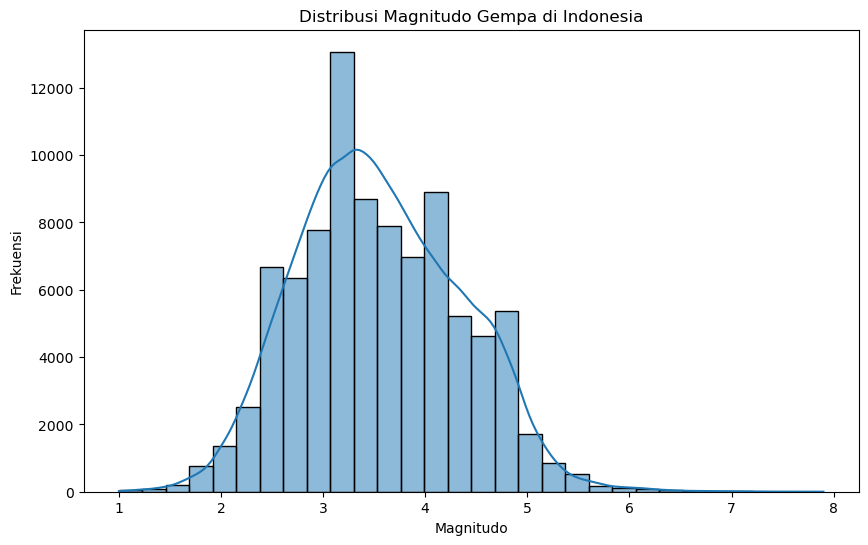

In [18]:
plt.figure(figsize=(10, 6))
sns.histplot(df['magnitude'], kde=True, bins=30)
plt.title('Distribusi Magnitudo Gempa di Indonesia')
plt.xlabel('Magnitudo')
plt.ylabel('Frekuensi')
plt.show()

#### Pengelompokan Magnitudo

<img src="https://indonesiabaik.id/public/uploads/post/6368/6368-1669356961-221124_IEI_Magnitudo,%20%20Ukuran%20Kekuatan%20Gempa%20yang%20Dipakai%20Indonesia_NH.jpeg" width="500"/>

In [19]:
list_mag = []
for i in df['magnitude'].tolist():
    t_mag = ''
    if i < 2.5:
        t_mag = 'Level 1 (< 2,5 M)'
    elif i < 5.5:
        t_mag = 'Level 2 (2,5 - 5,4 M)'
    elif i < 6.1:
        t_mag = 'Level 3 (5,5 - 6,0 M)'
    elif i < 7.0:
        t_mag = 'Level 4 (6,1 - 6,9 M)'
    elif i < 8.0:
        t_mag = 'Level 5 (7,0 - 7,9 M)'
    else:
        t_mag = 'Level 6 (>= 8,0 M)'
    list_mag.append(t_mag)
df['magnitude_level'] = list_mag

new_cols = ['location', 'magnitude', 'depth_km', 'datetime', 'latitude', 'longitude', 'magnitude_level', 'year', 'month', 'hour']
df = df[new_cols]
df = df.reindex(columns = new_cols)
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 90152 entries, 0 to 92886
Data columns (total 10 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   location         90152 non-null  object        
 1   magnitude        90152 non-null  float64       
 2   depth_km         90152 non-null  int64         
 3   datetime         90152 non-null  datetime64[ns]
 4   latitude         90152 non-null  float64       
 5   longitude        90152 non-null  float64       
 6   magnitude_level  90152 non-null  object        
 7   year             90152 non-null  int32         
 8   month            90152 non-null  object        
 9   hour             90152 non-null  int32         
dtypes: datetime64[ns](1), float64(3), int32(2), int64(1), object(3)
memory usage: 8.9+ MB


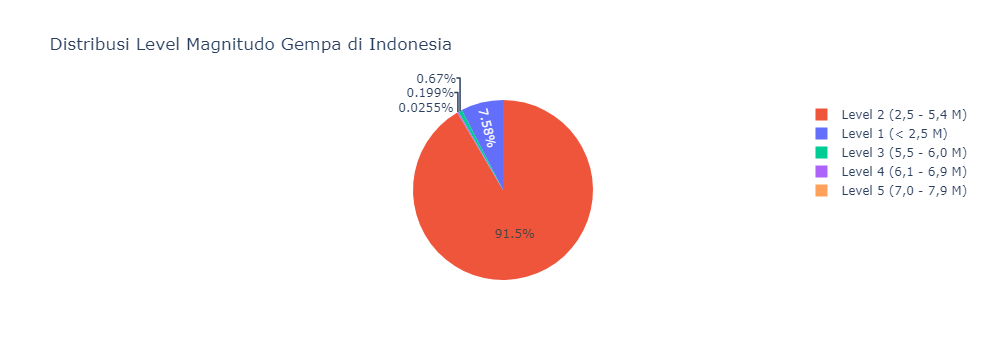

In [20]:
lvl_mag = df.groupby(['magnitude_level'], as_index = False, sort = True).count()

fig2 = px.pie(lvl_mag, values = 'location', names = 'magnitude_level', color = 'magnitude_level',
             title = 'Distribusi Level Magnitudo Gempa di Indonesia')
fig2.show()

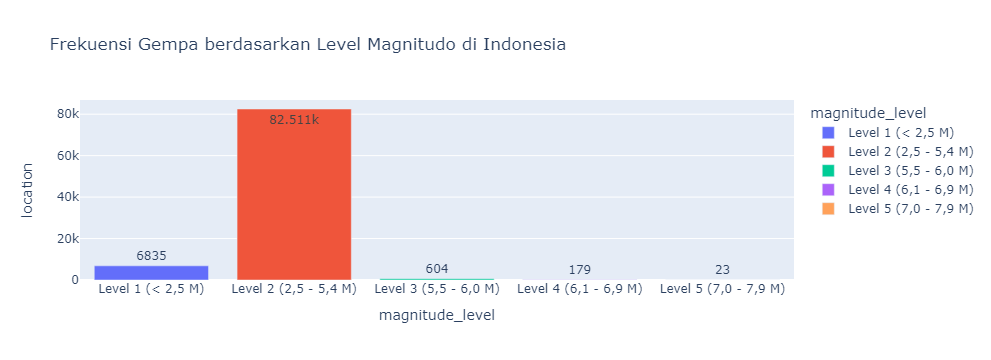

In [21]:
fig3 = px.bar(lvl_mag, x = 'magnitude_level', y = 'location', color = 'magnitude_level',
              text_auto = True, title = 'Frekuensi Gempa berdasarkan Level Magnitudo di Indonesia')
fig3.show()

In [22]:
df['magnitude_level'].value_counts().sort_index()

magnitude_level
Level 1 (< 2,5 M)         6835
Level 2 (2,5 - 5,4 M)    82511
Level 3 (5,5 - 6,0 M)      604
Level 4 (6,1 - 6,9 M)      179
Level 5 (7,0 - 7,9 M)       23
Name: count, dtype: int64

#### Analisis gempa dengan dampak sedang hingga serius (magnitudo level 3 ke atas)

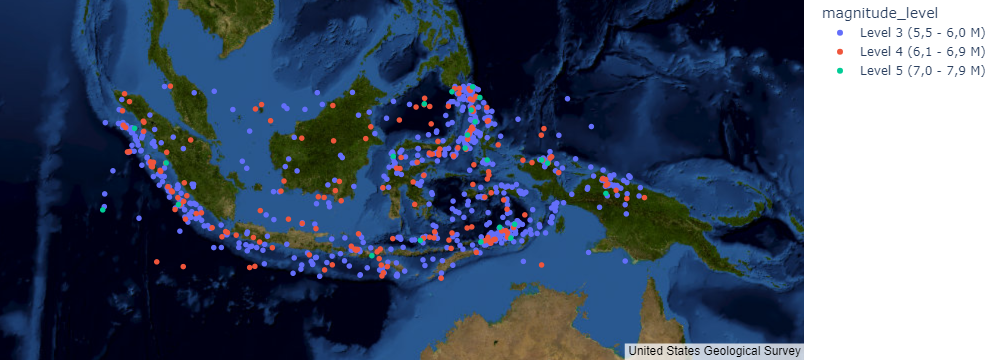

In [23]:
df_upmag = df[df['magnitude'] >= 5.5]
fig4 = px.scatter_mapbox(df_upmag, lat="latitude", lon="longitude", hover_name="location", hover_data=["magnitude", "depth_km"], color="magnitude_level", zoom=3, height=300)
fig4.update_layout(mapbox_style="white-bg", mapbox_layers=[{
            "below": 'traces',
            "sourcetype": "raster",
            "sourceattribution": "United States Geological Survey",
            "source": ["https://basemap.nationalmap.gov/arcgis/rest/services/USGSImageryOnly/MapServer/tile/{z}/{y}/{x}"]}])
fig4.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig4.show()

In [24]:
df_upmag['location'].value_counts()

location
Banda Sea                             98
Southern Sumatra - Indonesia          63
Northern Molucca Sea                  52
Irian Jaya Region - Indonesia         50
Talaud Islands - Indonesia            45
Minahassa Peninsula - Sulawesi        41
Northern Sumatra - Indonesia          38
Mindanao - Philippines                31
Irian Jaya - Indonesia                27
Southwest of Sumatra - Indonesia      26
Java - Indonesia                      26
Halmahera - Indonesia                 24
Borneo                                23
Sulawesi - Indonesia                  23
Seram - Indonesia                     19
Sumbawa Region - Indonesia            18
Near North Coast of Irian Jaya        16
South of Java - Indonesia             15
Celebes Sea                           15
Tanimbar Islands Reg. - Indonesia     14
Timor Region                          13
Off West Coast of Northern Sumatra    13
Flores Sea                            12
Southern Molucca Sea                  12
Java Se

### Analisis berdasarkan waktu

#### Frekuensi gempa berdasarkan tahun

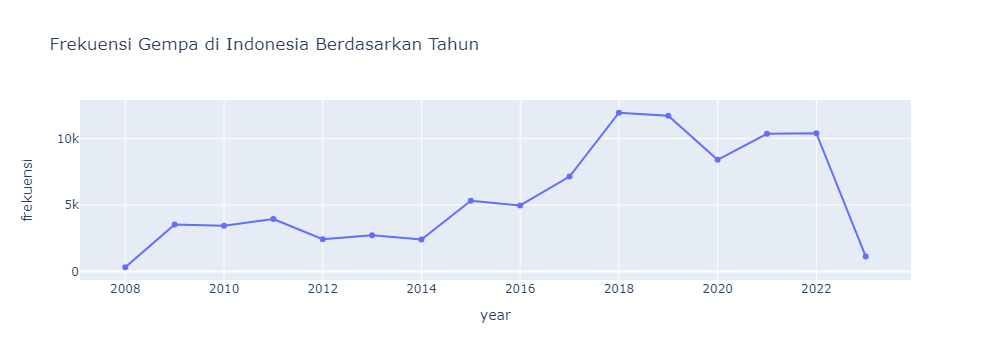

In [25]:
df = df.sort_values(by='datetime', ascending=True)
freq_year = df.groupby(['year'], as_index = False, sort = False).count()
fig5 = px.line(freq_year, x = 'year', y = 'location', markers = True, labels = {'location': 'frekuensi'}, title = 'Frekuensi Gempa di Indonesia Berdasarkan Tahun')
fig5.show()

In [26]:
df['year'].value_counts().sort_index()

year
2008      316
2009     3534
2010     3437
2011     3940
2012     2422
2013     2719
2014     2410
2015     5314
2016     4970
2017     7145
2018    11941
2019    11715
2020     8403
2021    10356
2022    10402
2023     1128
Name: count, dtype: int64

#### Frekuensi gempa berdasarkan bulan

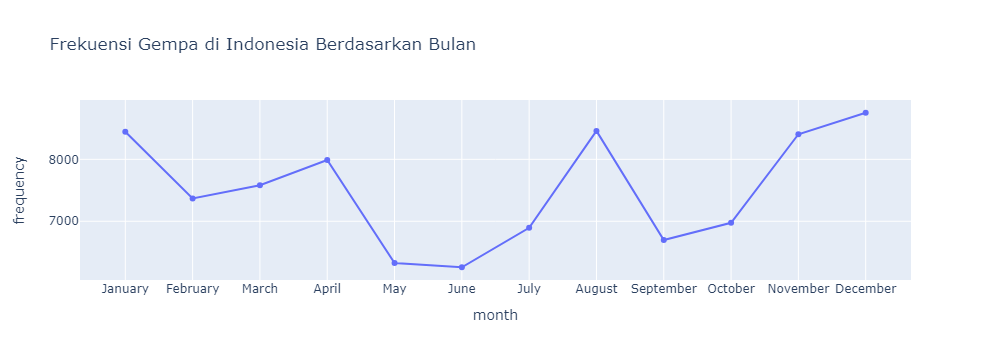

In [27]:
freq_month = df.groupby(['month'], as_index = False, sort = False).count()
month_ord = ['January', 'February', 'March', 'April', 'May', 'June', 'July','August','September','October','November','December']
freq_month.month = pd.Categorical(freq_month.month, categories = month_ord, ordered = True)
freq_month = freq_month.sort_values('month')
fig6 = px.line(freq_month, x = 'month', y = 'location', markers = True, labels = {'location': 'frequency'}, title = 'Frekuensi Gempa di Indonesia Berdasarkan Bulan')
fig6.show()

In [28]:
df['month'].value_counts()

month
December     8752
August       8459
January      8444
November     8405
April        7989
March        7583
February     7368
October      6975
July         6895
September    6698
May          6326
June         6258
Name: count, dtype: int64

#### Frekuensi gempa berdasarkan jam

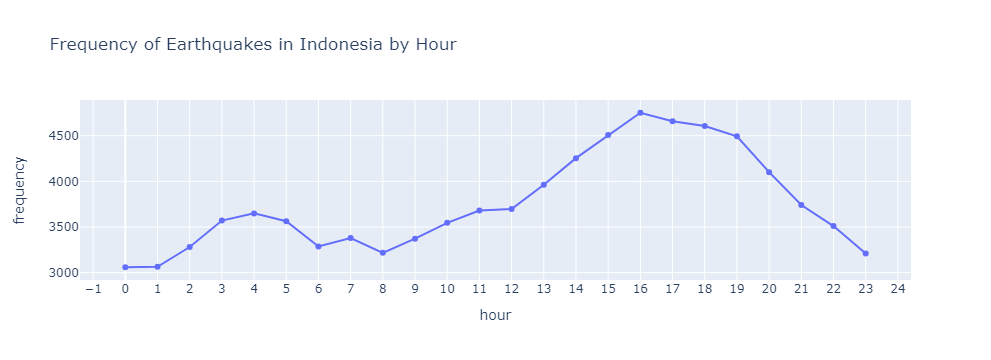

In [29]:
freq_hour = df.groupby(['hour'], as_index = False).count()
fig7 = px.line(freq_hour, x = 'hour', y = 'location', markers = True,labels = {'location': 'frequency'}, title = 'Frequency of Earthquakes in Indonesia by Hour')
fig7.update_layout(xaxis = dict(dtick = 1))
fig7.show()

In [30]:
df['hour'].value_counts()

hour
16    4751
17    4659
18    4605
15    4506
19    4493
14    4254
20    4100
13    3963
21    3740
12    3697
11    3681
4     3649
3     3570
5     3563
10    3545
22    3510
7     3378
9     3372
6     3286
2     3281
8     3217
23    3209
1     3064
0     3059
Name: count, dtype: int64

### Analisis magnitudo gempa terhadap kedalaman

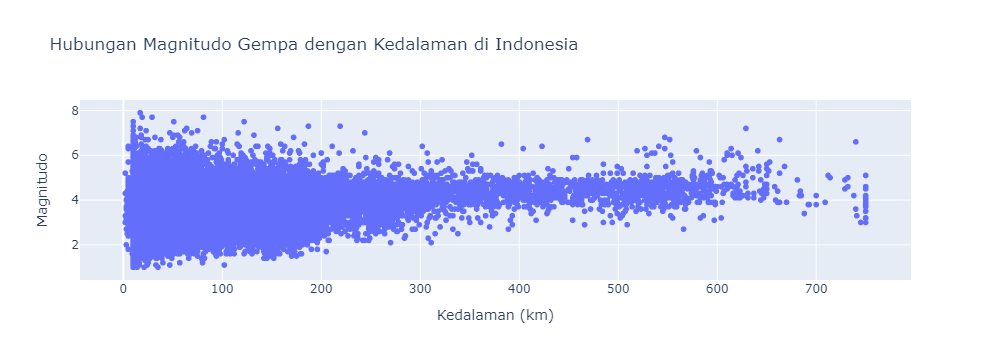

In [31]:
fig10 = px.scatter(df, x = 'depth_km', y = 'magnitude',
                  labels = {'depth_km': 'Kedalaman (km)', 'magnitude': 'Magnitudo'},
                  title = 'Hubungan Magnitudo Gempa dengan Kedalaman di Indonesia')
fig10.show()

## Selesai
Terima kasih telah menyaksikan.